In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib as mpl

from matplotlib import pyplot as plt
from keplergl import KeplerGl
from pandas_profiling import ProfileReport

%matplotlib inline
mpl.style.use("seaborn")

print("Pandas Version: " + pd.__version__)
print("Numpy Version: " + np.__version__)
print("Seaborn Version: " + sns.__version__)

Pandas Version: 1.2.0
Numpy Version: 1.18.5
Seaborn Version: 0.11.1


In [2]:
FREQUENT_USER_ACTIVE_DAYS_MIN = 28
FREQUENT_USER_THRESHOLD = 4

In [3]:
trips = pd.read_csv("../data/clean/trips.csv", parse_dates=["date_from", "date_until"])
trips.head(3)

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km
0,143517,A821059B555C7764A2FF801180874A2FCB326222,2014-01-01 00:34:54,2014-01-01 00:50:14,U-Bahn Baumwall,214170,Mönckebergstraße / Rosenstraße,131880,iPhone SRH,16,1.293661
1,119830,1EBC930DB407ACEAE2FDE23A6CA40492EA3DFBB2,2014-01-01 01:39:55,2014-01-01 01:57:27,Bahnhof Altona Ost/Max-Brauer-Allee,131646,Schulterblatt/Eifflerstraße,131648,Android SRH,18,2.032271
2,143501,7AD2C1B70137479062A6DD73815835986677BB2D,2014-01-01 01:40:20,2014-01-01 01:53:09,Weidestraße/Biedermannplatz,211922,Jarrestraße / Rambatzweg,138376,Techniker HH_119 (-2334-),13,0.954178


In [9]:
users = pd.read_csv("../data/clean/users.csv", parse_dates=["date_from_min", "date_from_max"])
users.head(3)

,user_id,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh
0,0000020B772C8D71F4F9AE4835D6C9F032FDBE21,2014-08-03 00:43:54,2017-05-12 19:42:34,67,1013,1017,3,12.552239,1.745649,8.424212
1,000004354587D5BAC99A2171DE2F4ACD30AA8635,2014-03-10 08:42:55,2016-11-17 12:11:25,8,983,1162,179,15.625000,0.953377,3.693612
2,00005721E978458AD348C24219138429BC84574A,2016-06-19 21:02:32,2017-05-15 16:05:15,99,329,330,0,10.252525,1.439436,8.760295


In [4]:
stations = pd.read_csv("../data/clean/stations.csv")
stations = stations[["station_id", "name", "latitude", "longitude"]]
stations.head(3)

,station_id,name,latitude,longitude
0,131543,Landungsbrücke/Hafentor,53.5457,9.97230
1,131546,Fischmarkt/Breite Straße,53.5462,9.95088
2,131547,Paulinenplatz/Wohlwillstraße,53.5542,9.96246


<AxesSubplot:>

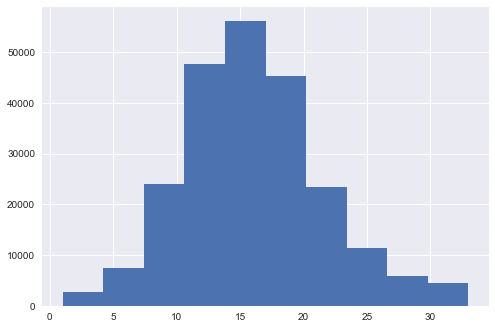

In [17]:
users.mean_duration_in_min.hist()

<AxesSubplot:>

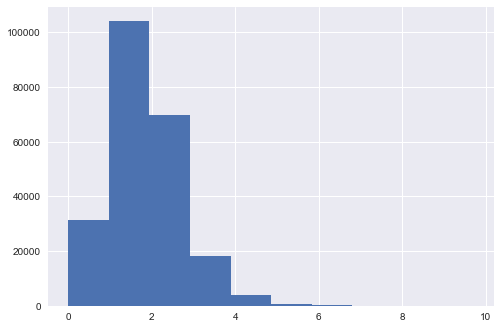

In [18]:
users.mean_distance_in_km.hist()

In [26]:
users.sort_values(by="mean_speed_in_kmh", ascending=False).head(20)

,user_id,date_from_min,date_from_max,trips_count,active_period_in_days,days_since_first_activity,days_since_last_activity,mean_duration_in_min,mean_distance_in_km,mean_speed_in_kmh
31195,22BC0D4DBD4A130DCE9C0475A712A7CE7710C44B,2016-03-09 11:58:57,2016-03-09 11:58:57,1,0,432,432,1.000000,6.126050,367.562996
87028,610C24A327373B6DE30A129C888EC7BF2E545456,2016-07-31 08:52:14,2016-07-31 09:05:35,2,0,288,288,2.000000,5.621377,337.282609
150723,A8A7C0FBB964BD931823DD5A989E8BD886D2DF72,2014-04-20 13:09:52,2014-04-20 13:09:52,1,0,1121,1121,1.000000,5.169795,310.187723
45408,3290003796FB8F3BD5487CFF9F50AEE7E7A7960A,2016-06-11 13:05:30,2016-06-11 13:05:30,1,0,338,338,1.000000,4.325971,259.558280
173182,C2179E0EADDC9A3972F9CD0F74074DF2BADB0F20,2014-08-10 13:59:55,2014-08-10 23:27:33,3,0,1009,1009,1.666667,4.311069,258.664169
99080,6E91546B46EC70392A8633A92A0C8202C40208C0,2014-05-25 15:24:11,2014-05-25 15:24:11,1,0,1086,1086,1.000000,3.336789,200.207314
226482,FD9C62D7EC0A7A706F04EDC940C9E0C50443E056,2016-09-10 12:34:59,2016-09-10 13:56:57,2,0,247,247,4.500000,3.129422,187.765319
211694,ED2EDF918D0449B8628152E50803E76C321E869D,2016-09-03 16:09:27,2016-09-03 16:09:27,1,0,254,254,2.000000,6.058878,181.766353
164622,B8426009C261EBA6CA46363F22A5EAC7137A5AB0,2015-04-21 16:39:19,2015-04-21 16:39:19,1,0,755,755,2.000000,6.011467,180.344006
217047,F33594FB164A8C25387DF510DE61CCA563B7B50C,2016-12-30 02:56:09,2016-12-30 02:56:09,1,0,137,137,3.000000,8.838614,176.772275


In [32]:
trips[trips.user_id == "F33594FB164A8C25387DF510DE61CCA563B7B50C"]

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,speed_in_kmh
6848186,107052,F33594FB164A8C25387DF510DE61CCA563B7B50C,2016-12-30 02:56:09,2016-12-30 02:58:51,Mundsburg / Schürbeker Straße,140799,Langenhorn Markt/Tangstedter Landstraße,247851,Unknown,3,8.838614,176.772275


In [42]:
trips[trips.speed_in_kmh > 15]

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,speed_in_kmh
613,117484,448C55A798DD94A63BB6791FB2C1C7DB229DB77D,2014-01-01 04:08:00,2014-01-01 04:22:53,Hauptbahnhof Ost / Hachmannplatz,131873,Eimsbütteler Straße/Waterloostraße,131644,Terminal HH_34 (-2541-),15,3.830942,15.323768
634,120192,F6F7F08413B3923E6939F4188D44987576A18BDF,2014-01-01 07:20:54,2014-01-01 07:25:19,Wiesendamm/Roggenkamp,212607,Jarrestraße / Rambatzweg,138376,Android SRH,5,1.486782,17.841387
842,119684,E6A2A7B2F8F8ABB8EC605C04AD27B9B8BC98369C,2014-01-01 10:06:07,2014-01-01 10:14:05,Millerntorplatz/St.Pauli,131905,Allende-Platz/Grindelhof,198077,iPhone SRH,8,2.046907,15.351802
1155,119833,028564DCB634057BF2AA3CE17A13142A7EB67056,2014-01-01 05:15:32,2014-01-01 05:24:53,Hauptbahnhof Ost / Hachmannplatz,131873,Wandsbeker Chaussee/Ritterstraße,204030,iPhone SRH,10,2.827057,16.962342
1429,120327,3C391304CA57E025B6D96E541D08A7419D8EAB69,2014-01-01 04:00:08,2014-01-01 04:05:08,Bahnhof Altona Ost/Max-Brauer-Allee,131646,Alsenstraße/Düppelstraße,211706,Android SRH,5,1.464497,17.573965
...,...,...,...,...,...,...,...,...,...,...,...,...
7669772,108021,1CB99259561263D472AA73AFA8CA01B44533B832,2017-05-15 20:51:48,2017-05-15 21:07:04,Siemersplatz/Kollaustraße,252484,Röntgenstraße/Philips,256467,iPhone SRH,16,4.122896,15.460861
7669834,120292,7396918F5B3C148ECC073F170A1472B61BFE2498,2017-05-15 20:56:25,2017-05-15 21:19:31,Emilienstraße/Fruchtallee,213825,Osdorfer Landstraße/ Elbe-Einkaufszentrum,252500,Android SRH,24,6.009610,15.024024
7669864,110363,3016E8C21DADA890D97CE83E5EC0C47CD6D2EA0B,2017-05-16 02:54:28,2017-05-16 03:00:00,Wartenau / Lübecker Straße,140801,Winterhuder Weg/ Zimmerstraße,208292,iPhone SRH,6,1.586119,15.861187
7669924,143563,0B85C74C9AFD8B9AA3E14C4CB7292DB74D87234F,2017-05-16 06:44:26,2017-05-16 07:01:21,Wandsbeker Chaussee/ Börnestraße,227415,Jacobikirche / Steinstraße,131875,Techniker HH_134 (-2413-),17,4.452529,15.714808


<AxesSubplot:>

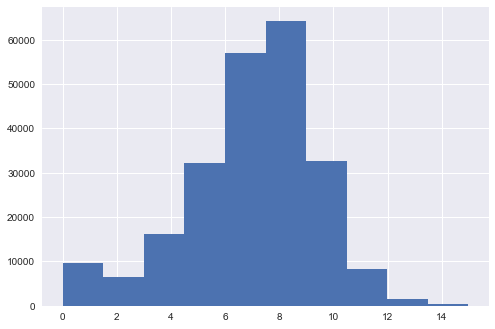

In [45]:
users[users.mean_speed_in_kmh < 15].mean_speed_in_kmh.hist()

In [40]:
trips.speed_in_kmh.quantile(0.99)

14.784522922984792

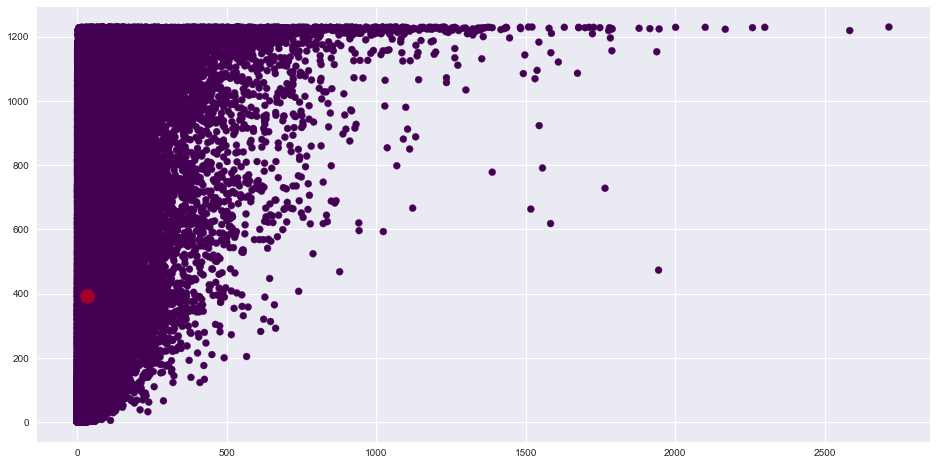

In [21]:
from sklearn.cluster import KMeans

features = (
    users.trips_count, 
    users.active_period_in_days, 
    users.mean_duration_in_min, 
    users.mean_distance_in_km, 
    users.mean_speed_in_kmh,
)
X = np.column_stack(features)
clusters = 1

kmeans = KMeans(clusters)
kmeans.fit(X)
y_kmeans = kmeans.fit_predict(X)
centers = kmeans.cluster_centers_

plt.figure(figsize=(16,8))
plt.scatter(X[:, 0], X[:, 1], c=y_kmeans, cmap="viridis")
plt.scatter(centers[:, 0], centers[:, 1], s=200, alpha=0.5, c="red");

In [7]:
# Defining users as 'casual' or 'frequent' based on activity patterns.

def is_frequent_user(trips_count, active_period_in_days):
    return (
        (active_period_in_days / trips_count) <= FREQUENT_USER_THRESHOLD
    ) & (
        active_period_in_days >= FREQUENT_USER_ACTIVE_DAYS_MIN
    )

users["is_frequent_user"] = users.apply(lambda x: is_frequent_user(x["trips_count"], x["active_period_in_days"]), axis=1)

In [8]:
# Defining users as 'casual' or 'frequent' based on activity patterns.

def user_type(trips_count, active_period_in_days):
    if (
        (active_period_in_days / trips_count) <= FREQUENT_USER_THRESHOLD
    ) & (
        active_period_in_days >= FREQUENT_USER_ACTIVE_DAYS_MIN
    ):
        return "frequent"
    else:
        return "casual"

users["type"] = users.apply(lambda x: user_type(x["trips_count"], x["active_period_in_days"]), axis=1)

In [9]:
users[users.is_frequent_user == True].sample(5)

,user_id,date_from_min,date_from_max,trips_count,active_period_in_days,is_frequent_user,type
225524,FC87FC74A7CE245C35FAA038AAFB47AE04500B63,2014-02-24 11:17:46,2017-01-23 09:36:47,337,1063,True,frequent
165359,B912B93BE8B561054F2A1C96EA9517C7CEBF0BD5,2015-04-22 19:35:08,2015-09-23 08:28:49,114,153,True,frequent
135114,97148039BA1460B3DD137B5D3156635A654D0229,2014-04-26 15:10:22,2017-05-13 17:27:56,499,1113,True,frequent
69111,4CD6F27C2C056B1D1C75B5451DCD4E203F198759,2015-07-09 19:16:59,2017-05-07 14:55:39,317,667,True,frequent
23425,1A1A6ABC09DFD6A5CD59EA8F166FCFE00D735A1E,2014-09-16 08:17:23,2014-11-09 12:54:34,59,54,True,frequent


In [10]:
users[users.is_frequent_user == False].sample(5)

,user_id,date_from_min,date_from_max,trips_count,active_period_in_days,is_frequent_user,type
93397,6836E1CBAB9F1452D6960F127BCA093FF0184718,2016-07-03 12:32:03,2017-05-15 06:57:55,37,315,False,casual
37801,2A0615EBDB1FF79E6B40B27E76E0C27491E4DE83,2014-01-04 20:25:41,2014-01-06 09:36:20,3,1,False,casual
139866,9C6CE373A11A241DBBF35F653ABC8ABCDA7022D3,2014-09-30 15:13:02,2017-02-27 18:22:41,69,881,False,casual
30792,22513AF502BE8187CD775F1FA4513452A1DDB1F2,2015-08-08 02:34:45,2015-08-14 12:32:39,4,6,False,casual
179676,C940B0AAE3C5F608EC7C2A149E8586FE5C023468,2016-10-25 11:56:20,2016-10-29 17:54:12,10,4,False,casual


In [11]:
#ProfileReport(users).to_notebook_iframe()

In [12]:
frequent_user_ids = users[users.is_frequent_user == True].user_id.unique()

frequent_user_trips = trips.loc[trips["user_id"].isin(frequent_user_ids)]
casual_user_trips = trips.loc[~trips["user_id"].isin(frequent_user_ids)]

In [13]:
#ProfileReport(frequent_user_trips).to_notebook_iframe()

In [14]:
#ProfileReport(casual_user_trips).to_notebook_iframe()

In [15]:
trips.loc[trips.user_id.isin(frequent_user_ids), "user_type"] = "frequent"
trips.loc[~trips.user_id.isin(frequent_user_ids), "user_type"] = "casual"
trips["user_type"] = trips["user_type"].astype("category")
trips.sample(3)

,bike_id,user_id,date_from,date_until,start_station_name,start_station_id,end_station_name,end_station_id,booked_via,duration_in_min,distance_in_km,user_type
6920279,110680,93C0E88E7A6DC8639B5290966FD81EB56364F275,2017-01-18 09:48:52,2017-01-18 09:52:54,Hallerstraße / Rohtenbaumchaussee,137995,Universität / Schlüterstraße,131881,iPhone SRH,5,0.596587,casual
4934056,120186,DC24853779A71451790CD03ECD8297EAAADF7639,2016-05-08 16:25:01,2016-05-08 16:47:34,Eduard-Rhein-Ufer / Schwanenwik,140800,Südring/Stadthallenbrücke,203892,IVR,23,2.803614,casual
1687889,120222,DD8B1810423ECFCAE34C8C100636E55D4A3D3CDC,2014-10-03 20:31:18,2014-10-03 20:56:35,Goebenstraße/Eppendorfer Weg,131641,Bebelallee/Meenkwiese,213855,Terminal HH_61 (-2242-),26,3.161308,casual


<AxesSubplot:xlabel='duration_in_min', ylabel='Count'>

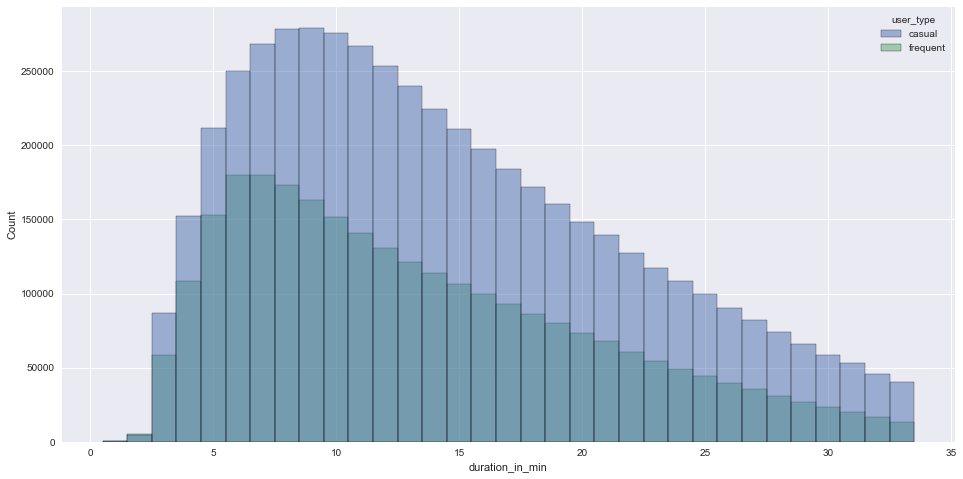

In [16]:
plt.figure(figsize=(16, 8))
sns.histplot(trips, x="duration_in_min", hue="user_type", element="bars", discrete=True)

<AxesSubplot:xlabel='distance_in_km', ylabel='Count'>

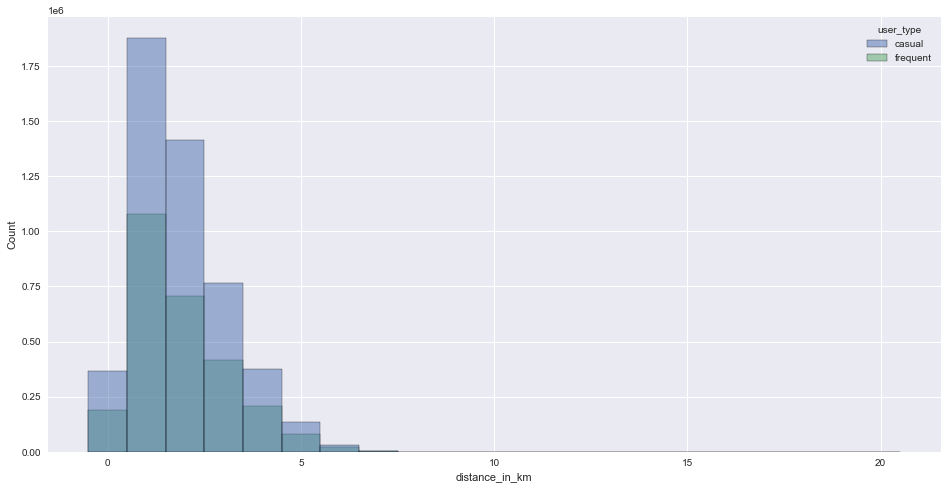

In [17]:
plt.figure(figsize=(16, 8))
sns.histplot(trips, x="distance_in_km", hue="user_type", element="bars", discrete=True)

In [18]:
casual = trips[trips.user_type == "casual"]
frequent = trips[trips.user_type == "frequent"]

<AxesSubplot:>

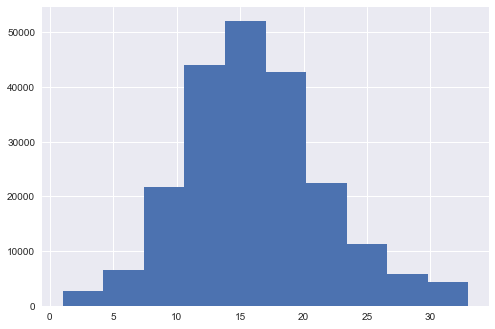

In [19]:
casual.groupby(["user_id"]).duration_in_min.mean().hist()

<AxesSubplot:>

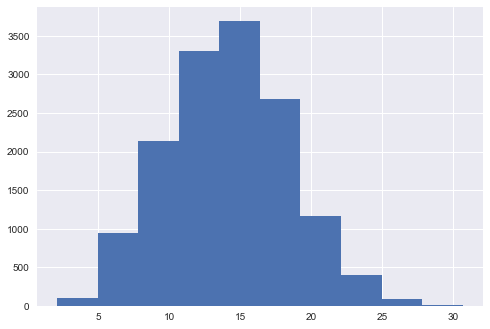

In [20]:
frequent.groupby(["user_id"]).duration_in_min.mean().hist()

In [21]:
mean_duration = trips.groupby(["user_id"]).duration_in_min.mean().to_frame()
mean_duration.rename(columns={"duration_in_min": "mean_duration"}, inplace=True)
mean_distance = trips.groupby(["user_id"]).distance_in_km.mean().to_frame()
mean_distance.rename(columns={"distance_in_km": "mean_distance"}, inplace=True)

users = users.merge(mean_duration, left_on="user_id", right_index=True, sort=False)
users = users.merge(mean_distance, left_on="user_id", right_index=True, sort=False)

In [22]:
users

,user_id,date_from_min,date_from_max,trips_count,active_period_in_days,is_frequent_user,type,mean_duration,mean_distance
0,0000020B772C8D71F4F9AE4835D6C9F032FDBE21,2014-08-03 00:43:54,2017-05-12 19:42:34,67,1013,False,casual,12.552239,1.745649
1,000004354587D5BAC99A2171DE2F4ACD30AA8635,2014-03-10 08:42:55,2016-11-17 12:11:25,8,983,False,casual,15.625000,0.953377
2,00005721E978458AD348C24219138429BC84574A,2016-06-19 21:02:32,2017-05-15 16:05:15,99,329,True,frequent,10.252525,1.439436
3,0000746235E82AD76B690086FFEB6D55A32C61C8,2014-06-25 21:40:19,2017-05-15 15:46:03,10,1054,False,casual,14.500000,1.792505
4,000080D6DF2166894262ADFBADD581AB6A20E481,2015-03-08 14:10:26,2015-03-08 14:54:02,3,0,False,casual,22.333333,1.047813
...,...,...,...,...,...,...,...,...,...
228549,FFFEEF2473DD8F9E327D8054332B3D127C835CCD,2014-03-03 20:22:26,2017-05-15 17:13:59,106,1168,False,casual,15.358491,2.635322
228550,FFFF0AF80E4B20974E4F0FEDB0C1AC36BC145469,2014-06-22 01:35:38,2014-08-02 00:03:10,2,40,False,casual,21.000000,3.077671
228551,FFFF6F2B370F6D7BFB02D4C05B333622358735A2,2014-04-24 14:10:05,2014-04-30 18:37:55,4,6,False,casual,17.250000,2.866037
228552,FFFFB52F01C697F11E9245BFC790A803EC1F9156,2016-09-13 18:09:19,2017-05-04 18:44:01,28,233,False,casual,16.000000,1.410046


<AxesSubplot:xlabel='mean_duration', ylabel='Count'>

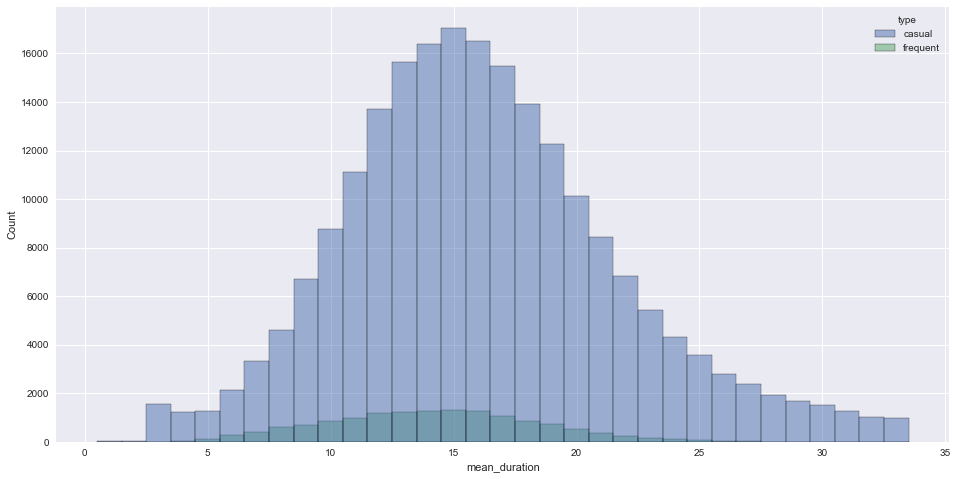

In [23]:
plt.figure(figsize=(16, 8))
sns.histplot(users, x="mean_duration", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_duration', ylabel='Count'>

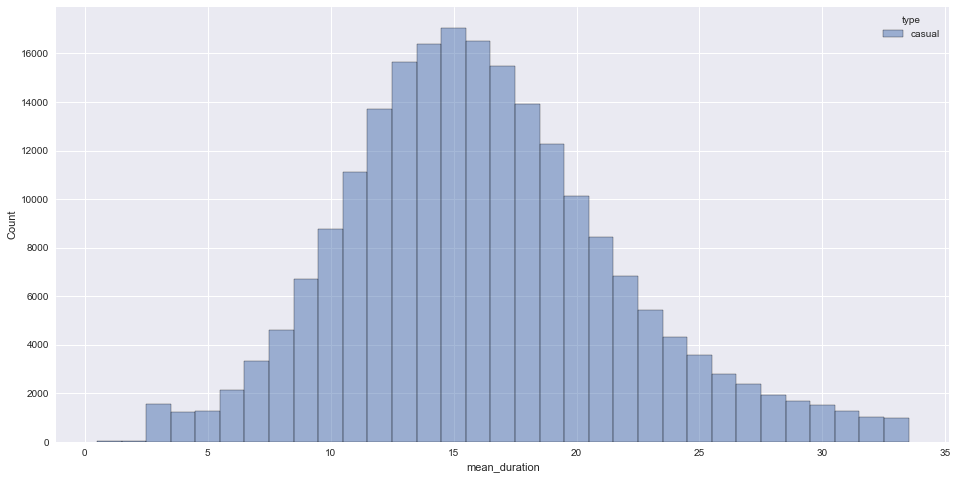

In [24]:
plt.figure(figsize=(16, 8))
sns.histplot(users[users.type == "casual"], x="mean_duration", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_duration', ylabel='Count'>

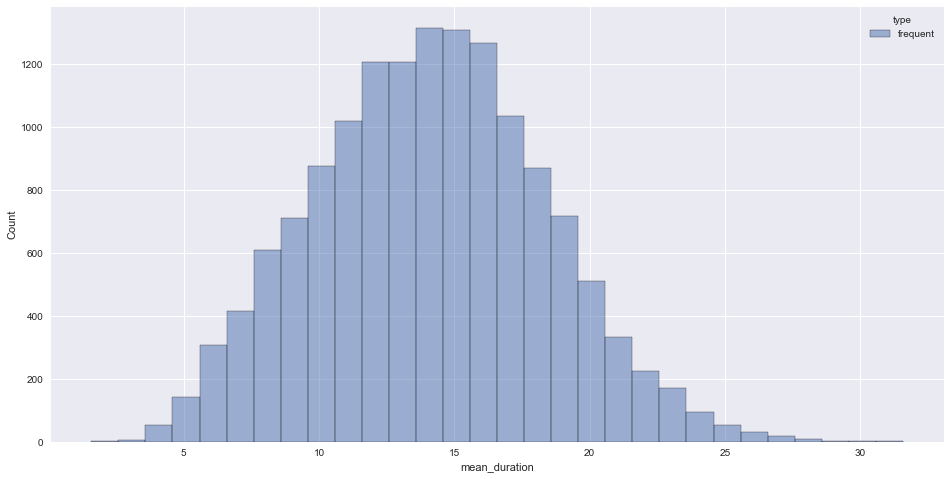

In [25]:
plt.figure(figsize=(16, 8))
sns.histplot(users[users.type == "frequent"], x="mean_duration", hue="type", element="bars", discrete=True)

<AxesSubplot:xlabel='mean_distance', ylabel='Count'>

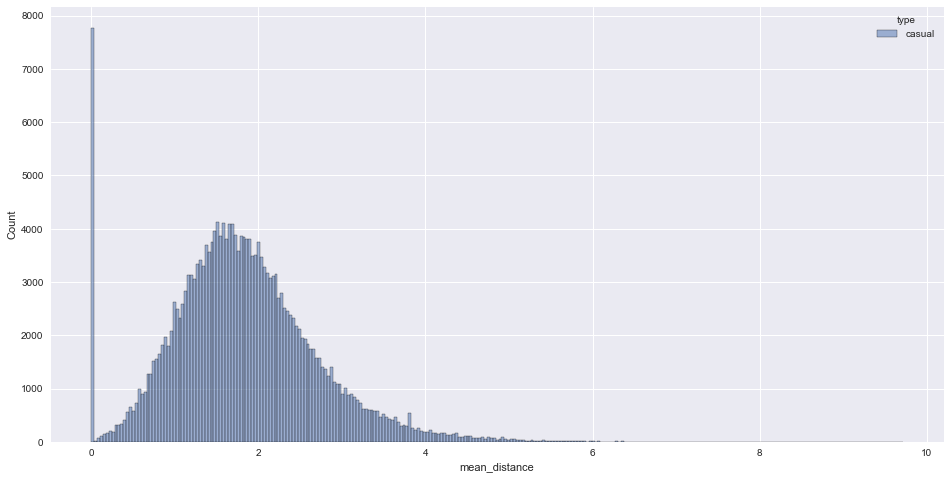

In [26]:
plt.figure(figsize=(16, 8))
sns.histplot(users[users.type == "casual"], x="mean_distance", hue="type")

In [27]:
users[users.type == "casual"].describe()

,trips_count,active_period_in_days,mean_duration,mean_distance
count,214034.000000,214034.000000,214034.000000,214034.000000
mean,23.206453,390.387994,16.125156,1.820997
std,37.518540,416.162677,5.547104,0.881002
min,1.000000,0.000000,1.000000,0.000000
25%,3.000000,0.000000,12.400000,1.264159
50%,8.000000,244.000000,15.666667,1.755494
75%,26.000000,746.000000,19.333333,2.306478
max,306.000000,1230.000000,33.000000,9.715023


In [28]:
trips[trips.user_type == "casual"].describe()

,bike_id,start_station_id,end_station_id,duration_in_min,distance_in_km
count,4.966970e+06,4.966970e+06,4.966970e+06,4.966970e+06,4.966970e+06
mean,1.215024e+05,1.690294e+05,1.696778e+05,1.446885e+01,1.876302e+00
std,1.075046e+04,4.133494e+04,4.142307e+04,7.437770e+00,1.198112e+00
min,1.060220e+05,1.315430e+05,1.315430e+05,1.000000e+00,0.000000e+00
25%,1.172390e+05,1.318850e+05,1.318870e+05,8.000000e+00,9.795859e-01
50%,1.199430e+05,1.407950e+05,1.407960e+05,1.300000e+01,1.620576e+00
75%,1.205240e+05,2.083070e+05,2.117060e+05,2.000000e+01,2.569727e+00
max,1.438660e+05,2.683580e+05,2.683580e+05,3.300000e+01,1.919140e+01


In [29]:
users[users.type == "frequent"].describe()

,trips_count,active_period_in_days,mean_duration,mean_distance
count,14520.000000,14520.000000,14520.000000,14520.000000
mean,186.155647,404.581956,14.115100,1.883960
std,227.290454,409.709056,4.262430,0.785827
min,7.000000,28.000000,2.079086,0.000000
25%,35.000000,67.000000,11.097456,1.315712
50%,99.000000,229.000000,14.142857,1.791260
75%,271.000000,662.000000,17.000000,2.329998
max,2714.000000,1231.000000,30.666667,6.561012


In [30]:
trips[trips.user_type == "frequent"].describe()

,bike_id,start_station_id,end_station_id,duration_in_min,distance_in_km
count,2.702980e+06,2.702980e+06,2.702980e+06,2.702980e+06,2.702980e+06
mean,1.208946e+05,1.712001e+05,1.709095e+05,1.330118e+01,1.885438e+00
std,1.072790e+04,4.196467e+04,4.184768e+04,7.194943e+00,1.232042e+00
min,1.060220e+05,1.315430e+05,1.315430e+05,1.000000e+00,0.000000e+00
25%,1.160100e+05,1.318870e+05,1.318870e+05,7.000000e+00,9.573496e-01
50%,1.198710e+05,1.407990e+05,1.407960e+05,1.200000e+01,1.570714e+00
75%,1.204900e+05,2.117090e+05,2.117090e+05,1.800000e+01,2.602317e+00
max,1.438660e+05,2.683580e+05,2.683580e+05,3.300000e+01,1.378492e+01


<AxesSubplot:xlabel='mean_distance', ylabel='Count'>

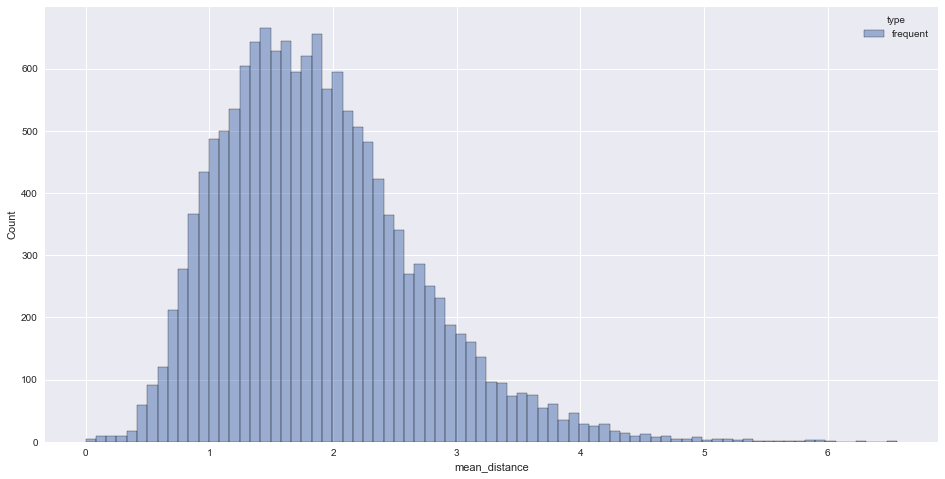

In [31]:
plt.figure(figsize=(16, 8))
sns.histplot(users[users.type == "frequent"], x="mean_distance", hue="type")

<Figure size 1152x576 with 0 Axes>

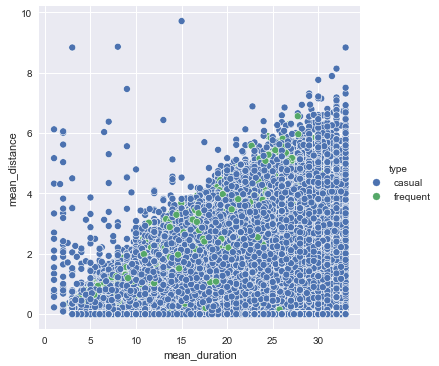

In [32]:
plt.figure(figsize=(16, 8))
sns.relplot(data=users, x="mean_duration", y="mean_distance", hue="type")

In [33]:
tmp = trips.copy()
tmp.loc[trips.booked_via.str.startswith("Terminal"), "booked_via"] = "Terminal"
tmp.loc[trips.booked_via.str.startswith("terminal"), "booked_via"] = "Terminal"
tmp.loc[trips.booked_via.str.startswith("Techniker"), "booked_via"] = "Techniker"
tmp.loc[trips.booked_via.str.startswith("Starenkasten"), "booked_via"] = "Starenkasten"

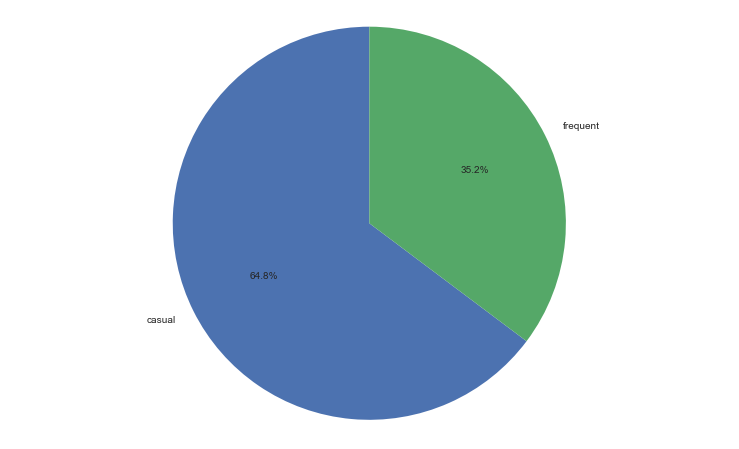

In [34]:
value_counts = tmp.user_type.value_counts()
fig1, ax1 = plt.subplots(figsize=(13,8))
ax1.pie(value_counts, labels=value_counts.index, autopct="%1.1f%%", startangle=90)
ax1.axis("equal")
plt.savefig("figures/user_types.png", bbox_inches="tight")
plt.show()

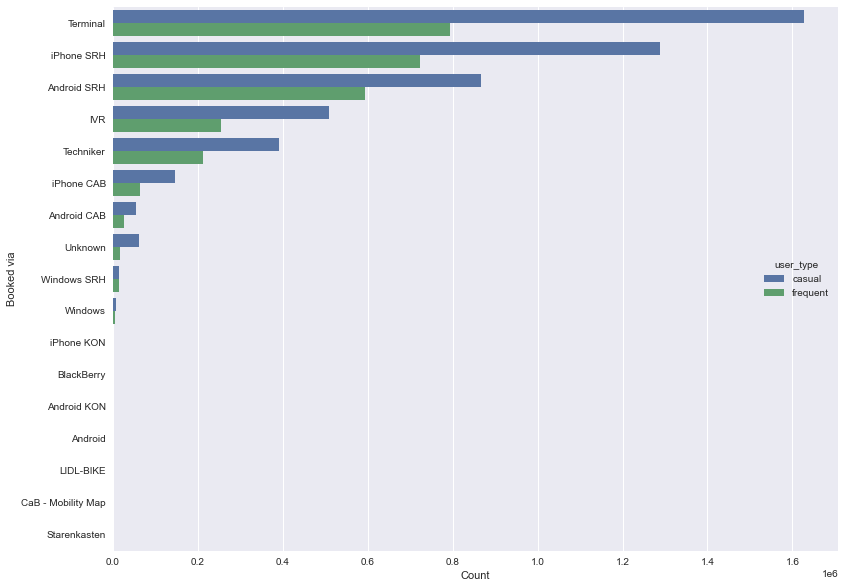

In [35]:
plt.figure(figsize=(13, 10))
ax = sns.countplot(
    data=tmp,
    y="booked_via",
    hue="user_type",
    order = tmp.booked_via.value_counts().index
)
ax.set(xlabel="Count", ylabel="Booked via")
plt.savefig("figures/booked_via.png", bbox_inches="tight")
plt.show()

In [56]:
# TODO the same for mean distance and duration

In [57]:
#pairs = trips[
#    ["date_from", "date_until", "start_station_id", "end_station_id", "start_station_name", "end_station_name"]
#]
#
#pairs = pd.merge(pairs, stations, left_on="start_station_id", right_on="station_id", how="left", sort=False)
#pairs.rename(columns={"latitude": "start_latitude", "longitude": "start_longitude"}, inplace=True)
#pairs.drop(["station_id", "name"], axis=1, inplace=True)
#
#pairs = pd.merge(pairs, stations, left_on="end_station_id", right_on="station_id", how="left", sort=False)
#pairs.rename(columns={"latitude": "end_latitude", "longitude": "end_longitude"}, inplace=True)
#pairs.drop(["station_id", "name"], axis=1, inplace=True)
#pairs

In [58]:
# Count occurrence of each pair (not symmetrically)
pair_count = trips.value_counts(subset=["start_station_name", "end_station_name"], sort=True).to_frame()
pair_count.reset_index(inplace=True)

# Rename column
pair_count.rename(columns={0: "count"}, inplace=True)

# Aggregate symmetrically
sorted_pairs = np.sort(pair_count[["start_station_name", "end_station_name"]], axis=1)
pair_count = pair_count.groupby([sorted_pairs[:,0], sorted_pairs[:,1]])["count"].sum().reset_index()

# Rename columns
pair_count.rename(columns={"level_0": "station_x", "level_1": "station_y"}, inplace=True)
pair_count

,station_x,station_y,count
0,Allende-Platz/Grindelhof,Allende-Platz/Grindelhof,4112
1,Allende-Platz/Grindelhof,Alsenstraße/Düppelstraße,3279
2,Allende-Platz/Grindelhof,Alsterdorf Markt/Evangelische Stiftung,46
3,Allende-Platz/Grindelhof,Alsterdorfer Straße/Fuhlsbüttler Straße,6
4,Allende-Platz/Grindelhof,Alsterschwimmhalle/Ifflandstraße,647
...,...,...,...
14010,Winterhuder Weg/ Zimmerstraße,Zentralbibliothek / Münzstraße,249
14011,Winterhuder Weg/ Zimmerstraße,Überseering/Mexikoring,378
14012,Zentralbibliothek / Münzstraße,Zentralbibliothek / Münzstraße,789
14013,Zentralbibliothek / Münzstraße,Überseering/Mexikoring,4


In [59]:
# Add coordinates to station pairs

pairs = pd.merge(pair_count, stations, left_on="station_x", right_on="name", how="left", sort=False)
pairs.rename(
    columns={
        "latitude": "latitude_x", 
        "longitude": "longitude_x",
    }, 
    inplace=True
)

pairs = pd.merge(pairs, stations, left_on="station_y", right_on="name", how="left", sort=False)
pairs.rename(
    columns={
        "latitude": "latitude_y", 
        "longitude": "longitude_y",
    }, 
    inplace=True
)

pairs.drop(columns=["station_id_x", "name_x", "station_id_y", "name_y"], inplace=True)
pairs

,station_x,station_y,count,latitude_x,longitude_x,latitude_y,longitude_y
0,Allende-Platz/Grindelhof,Allende-Platz/Grindelhof,4112,53.567845,9.982728,53.567845,9.982728
1,Allende-Platz/Grindelhof,Alsenstraße/Düppelstraße,3279,53.567845,9.982728,53.563037,9.948345
2,Allende-Platz/Grindelhof,Alsterdorf Markt/Evangelische Stiftung,46,53.567845,9.982728,53.612091,10.023946
3,Allende-Platz/Grindelhof,Alsterdorfer Straße/Fuhlsbüttler Straße,6,53.567845,9.982728,53.620000,10.032000
4,Allende-Platz/Grindelhof,Alsterschwimmhalle/Ifflandstraße,647,53.567845,9.982728,53.560781,10.022148
...,...,...,...,...,...,...,...
14010,Winterhuder Weg/ Zimmerstraße,Zentralbibliothek / Münzstraße,249,53.575308,10.020450,53.550332,10.008849
14011,Winterhuder Weg/ Zimmerstraße,Überseering/Mexikoring,378,53.575308,10.020450,53.601619,10.024745
14012,Zentralbibliothek / Münzstraße,Zentralbibliothek / Münzstraße,789,53.550332,10.008849,53.550332,10.008849
14013,Zentralbibliothek / Münzstraße,Überseering/Mexikoring,4,53.550332,10.008849,53.601619,10.024745


In [60]:
tmp = pairs.sort_values(by="count", ascending=False)
tmp[["count"]].describe()

,count
count,14015.000000
mean,547.267214
std,1303.999667
min,1.000000
25%,21.000000
50%,125.000000
75%,516.000000
max,35324.000000


array([[<AxesSubplot:title={'center':'count'}>]], dtype=object)

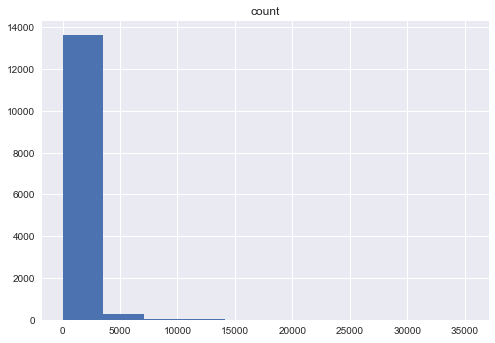

In [61]:
tmp[["count"]].hist()

In [62]:
tmp[tmp["count"] > 500].describe()

,count,latitude_x,longitude_x,latitude_y,longitude_y
count,3576.000000,3576.000000,3576.000000,3576.000000,3576.000000
mean,1816.744128,53.561949,9.992941,53.562117,9.994243
std,2110.026740,0.019935,0.033652,0.019922,0.033874
min,501.000000,53.447625,9.862013,53.447625,9.862013
25%,740.000000,53.551853,9.971720,53.551600,9.969601
50%,1164.500000,53.560200,9.990430,53.561109,9.990091
75%,2016.750000,53.575408,10.014900,53.575308,10.016000
max,35324.000000,53.654290,10.210913,53.648757,10.220000


In [63]:
tmp[tmp["count"] > 2000].describe()

,count,latitude_x,longitude_x,latitude_y,longitude_y
count,904.000000,904.000000,904.000000,904.000000,904.000000
mean,4179.494469,53.562299,9.990902,53.562529,9.991214
std,3106.157043,0.021362,0.032771,0.021488,0.032154
min,2004.000000,53.447625,9.878527,53.448960,9.887159
25%,2472.750000,53.552244,9.965669,53.552244,9.963824
50%,3161.500000,53.563037,9.989710,53.563600,9.987659
75%,4622.250000,53.575652,10.014900,53.575573,10.014900
max,35324.000000,53.654290,10.206105,53.648757,10.220000


In [64]:
tmp[tmp["count"] > 5000].describe()

,count,latitude_x,longitude_x,latitude_y,longitude_y
count,184.000000,184.000000,184.000000,184.000000,184.000000
mean,8610.945652,53.562373,9.986582,53.561210,9.985870
std,4488.097873,0.020278,0.030922,0.020108,0.030906
min,5008.000000,53.457286,9.927945,53.460622,9.914731
25%,5856.250000,53.552121,9.963083,53.552244,9.962395
50%,6989.500000,53.567200,9.982728,53.562709,9.977210
75%,9536.750000,53.574782,10.012770,53.573183,10.013995
max,35324.000000,53.594300,10.058237,53.594300,10.057613


array([[<AxesSubplot:title={'center':'count'}>]], dtype=object)

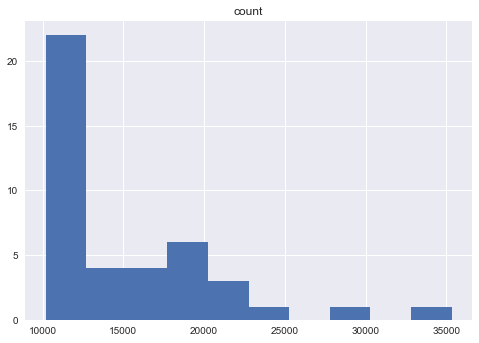

In [65]:
tmp[tmp["count"] > 10000][["count"]].hist()

In [66]:
tmp.head(100).describe()

,count,latitude_x,longitude_x,latitude_y,longitude_y
count,100.000000,100.000000,100.000000,100.000000,100.000000
mean,10937.580000,53.563845,9.990924,53.562825,9.990827
std,4998.700425,0.019088,0.031778,0.018491,0.031590
min,6872.000000,53.460687,9.933870,53.460622,9.914731
25%,7643.500000,53.553300,9.963063,53.553975,9.962444
50%,9354.500000,53.567773,9.990215,53.562709,9.986076
75%,11507.250000,53.576573,10.016200,53.574715,10.020613
max,35324.000000,53.592022,10.058237,53.594300,10.049568


In [67]:
tmp.head(10)

,station_x,station_y,count,latitude_x,longitude_x,latitude_y,longitude_y
1681,Bahnhof Altona West / Busbahnhof,Bahrenfelder Straße/Völckersstraße,35324,53.551800,9.933870,53.556897,9.927945
13305,Saarlandstraße/Wiesendamm,Schleidenstraße/Osterbekstraße,28565,53.588735,10.032680,53.584582,10.033690
12381,Mundsburg / Schürbeker Straße,Winterhuder Weg/ Zimmerstraße,23199,53.569600,10.027100,53.575308,10.020450
1028,Am Kaiserkai/Großer Grasbrook,U-Bahn Baumwall,21517,53.541838,9.992856,53.544279,9.980896
10537,Krausestraße/Eilbektal,Lortzingstraße/Friedrichsberger Straße,21438,53.576238,10.058237,53.573588,10.049568
970,Am Kaiserkai/Großer Grasbrook,Landungsbrücke/Hafentor,20358,53.541838,9.992856,53.545700,9.972300
8399,Hallerstraße / Rohtenbaumchaussee,Universität / Schlüterstraße,19770,53.572081,9.988801,53.566972,9.986076
5989,Eppendorfer Baum / Isestraße,Martinistraße / Haupteingang Klinikum,19528,53.583200,9.984410,53.588918,9.975715
10308,Kellinghusenstraße / Loogeplatz,Martinistraße / Haupteingang Klinikum,19000,53.588516,9.991125,53.588918,9.975715
10037,Jarrestraße / Rambatzweg,Mundsburg / Schürbeker Straße,18680,53.584000,10.021100,53.569600,10.027100


In [68]:
config = eval(open("calculations/map_config_most_popular.py", "r").read())
map = KeplerGl(height=700, data={"data": tmp.head(140), "stations": stations}, config=config)
map

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


KeplerGl(config={'version': 'v1', 'config': {'visState': {'filters': [], 'layers': [{'id': 'mz5vtjc', 'type': …

In [72]:
tmp.reset_index(drop=True).head(140)

,station_x,station_y,count,latitude_x,longitude_x,latitude_y,longitude_y
0,Bahnhof Altona West / Busbahnhof,Bahrenfelder Straße/Völckersstraße,35324,53.551800,9.933870,53.556897,9.927945
1,Saarlandstraße/Wiesendamm,Schleidenstraße/Osterbekstraße,28565,53.588735,10.032680,53.584582,10.033690
2,Mundsburg / Schürbeker Straße,Winterhuder Weg/ Zimmerstraße,23199,53.569600,10.027100,53.575308,10.020450
3,Am Kaiserkai/Großer Grasbrook,U-Bahn Baumwall,21517,53.541838,9.992856,53.544279,9.980896
4,Krausestraße/Eilbektal,Lortzingstraße/Friedrichsberger Straße,21438,53.576238,10.058237,53.573588,10.049568
...,...,...,...,...,...,...,...
14010,Große Rainstraße/Ottenser Hauptstraße,Osterbrookplatz/ Süderstraße,1,53.552339,9.930344,53.546932,10.057613
14011,Große Rainstraße/Ottenser Hauptstraße,Planetarium/Hindenburgstraße,1,53.552339,9.930344,53.595950,10.013650
14012,Meßberg / Willy-Brandt-Straße,Nordschleswiger Straße/Dulsberg-Nord,1,53.547805,9.998774,53.585813,10.065230
14013,Große Rainstraße/Ottenser Hauptstraße,Saarlandstraße/Wiesendamm,1,53.552339,9.930344,53.588735,10.032680


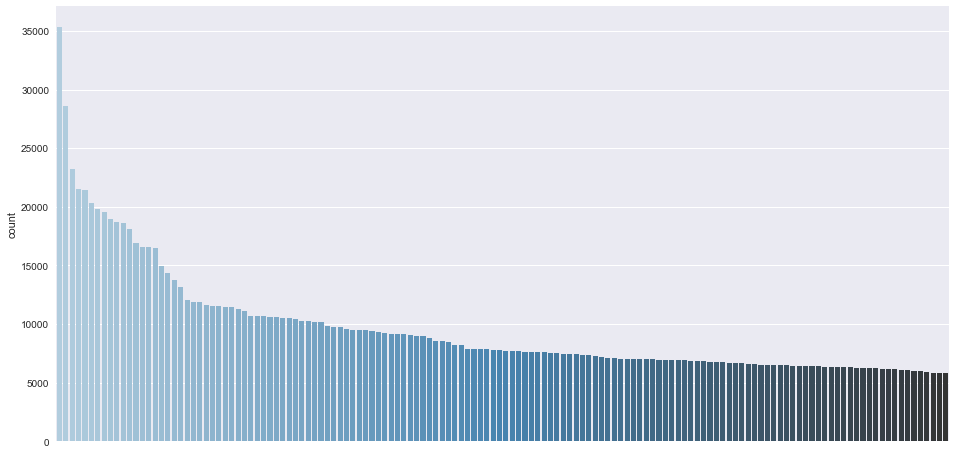

In [99]:
foo = tmp.head(140).reset_index(drop=True)

plt.figure(figsize=(16, 8))
ax = sns.barplot(y="count", x=foo.index, data=foo, palette="Blues_d")
ax.set(xticklabels=[])
plt.savefig("figures/stations_top140_dist.png", bbox_inches="tight")
plt.show()